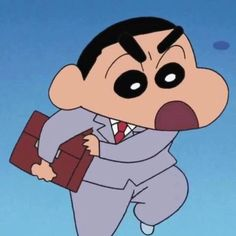

## 백엔드 개발자를 위한 MLOps

### 3.4 머신러닝 기본 원리 나아가기: 역전파(Backpropagation)

역전파 원리에 대해서 이해하면서 모델의 가중치 최적화 방법 이해

MNIST 학습 과정의 역전파 구현

In [1]:
import os
import shutil
import torch
import imageio
import torch.nn as nn
import torchvision.datasets as dsets
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
from itertools import islice
from torch.autograd import Variable
from IPython.display import Image, display

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [ ]:
input_size = 784  # 이미지 사이즈 = (너비: 28, 높이: 28) => 28 * 28 = 784 픽셀 해상도
hidden_size = 10  # 은닉 레이어 뉴런 수 (동작을 보기 위해 극단적으로 뉴런 수를 줄임)
num_classes = 10  # 숫자 0 ~ 9까지 총 10가지 종류의 클래스 선별 태스크
num_steps = 80        # 학습 스탭 (역전파 확인 목적으로 소규모로 제한)
num_epochs = 5    # 학습에 사용할 세대 수 (동작을 보기 위해 극단적으로 세대 수를 줄임)
batch_size = 100  # 매 학습 사이클의 입력 배치 크기
lr = 1e-3         # 학습에서 사용할 학습 진척도

In [2]:
train_data = dsets.MNIST(root = './data', train = True, transform = transforms.ToTensor(), download = True)
test_data = dsets.MNIST(root = './data', train = False, transform = transforms.ToTensor())

train_loader = torch.utils.data.DataLoader(dataset = train_data, batch_size = batch_size, shuffle = True)
test_loader = torch.utils.data.DataLoader(dataset = test_data, batch_size = batch_size, shuffle = False)

NameError: name 'dsets' is not defined

In [1]:
class Net(nn.Module):
  def __init__(self, input_size, hidden_size, num_classes):
    super(Net,self).__init__()
    self.fc1 = nn.Linear(input_size, hidden_size)
    self.relu = nn.ReLU()
    self.fc2 = nn.Linear(hidden_size, num_classes)

  def forward(self, x):
    out = self.fc1(x)
    out = self.relu(out)
    out = self.fc2(out)
    return out

NameError: name 'nn' is not defined

In [ ]:
net = Net(input_size, hidden_size, num_classes)
if torch.cuda.is_available():
  net.cuda()

loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(net.parameters(), lr=lr)

In [2]:
def create_combined_gif(loss_values: list[float], image_folder: str, gif_name: str, fps=30, loop=0):
    images: list[str] = []
    for epoch in range(num_epochs):
        for step in range(num_steps):
            weight_file = f"{image_folder}/weights_00_epoch_{epoch:02}_step_{step:02}.png"
            bias_file = f"{image_folder}/bias_00_epoch_{epoch:02}_step_{step:02}.png"
            if os.path.exists(weight_file) and os.path.exists(bias_file):
                fig, axs = plt.subplots(1, 3, figsize=(15, 5))

                axs[0].plot(loss_values[:epoch * 20 + step + 1])
                axs[0].set_title("Loss over Time")
                axs[0].set_xlabel("Step")
                axs[0].set_ylabel("Loss")

                weight_img = imageio.imread(weight_file)
                axs[1].imshow(weight_img)
                axs[1].set_title("Weights")

                bias_img = imageio.imread(bias_file)
                axs[2].imshow(bias_img)
                axs[2].set_title("Biases")

                plt.tight_layout()
                fig.canvas.draw()
                image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
                image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
                images.append(image)
                plt.close(fig)

    imageio.mimsave(gif_name, images, fps=fps, loop=loop)

In [3]:
def save_weights_bias_as_images(net: Net, epoch: int, step: int, folder: str):
    for layer_idx, layer in enumerate(net.children()):
        if isinstance(layer, nn.Linear):
            weights = layer.weight.data.cpu().numpy()
            plt.imshow(weights, cmap="viridis")
            plt.title(f"Layer: {layer_idx} (Weights) - Epoch: {epoch:02}, Step: {step:02}")
            plt.colorbar()
            plt.savefig(f"{folder}/weights_{layer_idx:02}_epoch_{epoch:02}_step_{step:02}.png")
            plt.close()

            bias = layer.bias.data.cpu().numpy()
            plt.plot(bias)
            plt.title(f"Layer: {layer_idx:02} (Bias) - Epoch: {epoch:02}, Step: {step:02}")
            plt.savefig(f"{folder}/bias_{layer_idx:02}_epoch_{epoch:02}_step_{step:02}.png")
            plt.close()

NameError: name 'Net' is not defined

In [4]:
# [Training]

gif_frame_image_folder = "weight_bias_images"
if os.path.exists(gif_frame_image_folder):
    shutil.rmtree(gif_frame_image_folder)
os.makedirs(gif_frame_image_folder)

loss_values: list[float] = []

for epoch in range(num_epochs):
    for i, (images, labels) in enumerate(islice(train_loader, num_steps)):
        images = Variable(images.view(-1, 28 * 28)).cuda()
        labels = Variable(labels).cuda()

        optimizer.zero_grad()
        outputs = net(images)
        loss = loss_function(outputs, labels)
        loss.backward()
        optimizer.step()

        save_weights_bias_as_images(net, epoch, i, gif_frame_image_folder)
        loss_values.append(loss.item())

        if (i+1) % 100 == 0:
            print("Epoch [%d/%d], Step [%d/%d], Loss: %.4f"
                  %(epoch+1, num_epochs, i+1, len(train_data)//batch_size, loss.data))

NameError: name 'os' is not defined

In [ ]:
# [Validation]

correct = 0
total = 0

for images, labels in test_loader:
  images = Variable(images.view(-1, 28 * 28)).cuda()
  labels = labels.cuda()

  output = net(images)
  _, predicted = torch.max(output, 1)
  correct += (predicted == labels).sum()
  total += labels.size(0)

print("Accuracy of the model: %.3f %%" %((100*correct)/(total+1)))

Accuracy of the model: 88.401 %


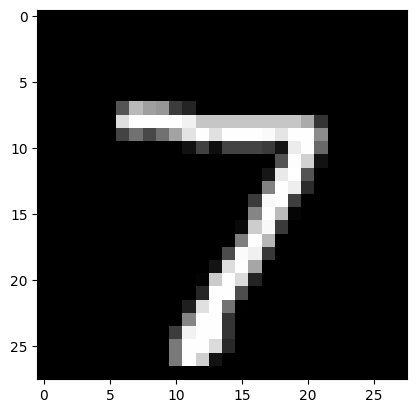

label=tensor(7)
pred=tensor([7], device='cuda:0')


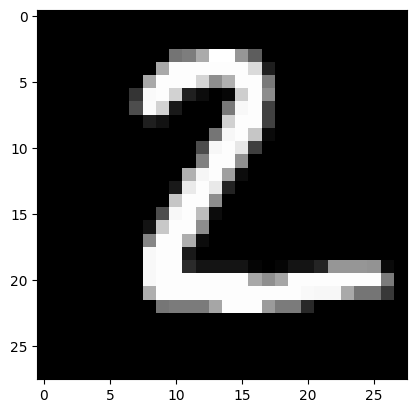

label=tensor(2)
pred=tensor([2], device='cuda:0')


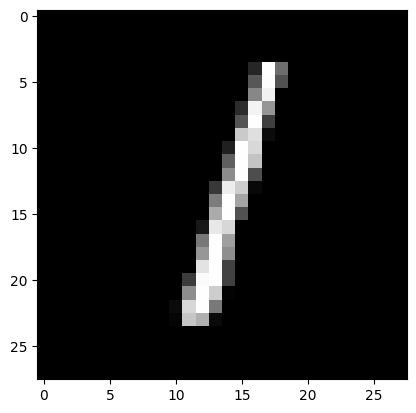

label=tensor(1)
pred=tensor([1], device='cuda:0')


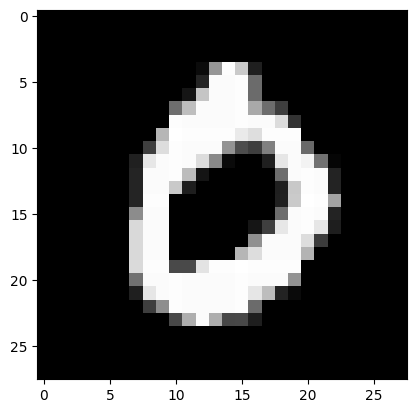

label=tensor(0)
pred=tensor([0], device='cuda:0')


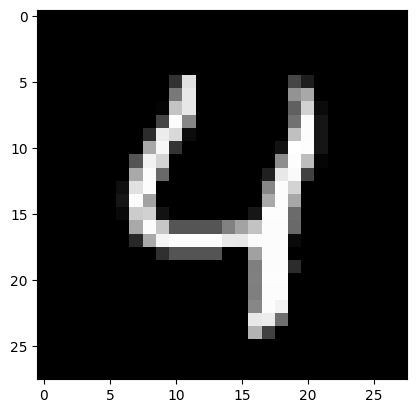

label=tensor(4)
pred=tensor([4], device='cuda:0')


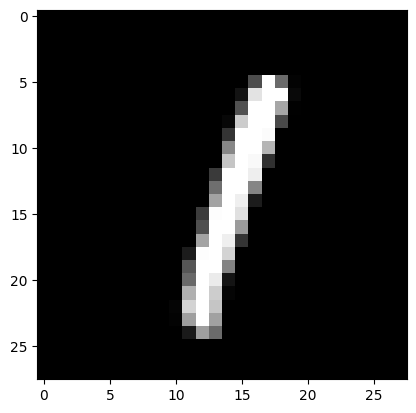

label=tensor(1)
pred=tensor([1], device='cuda:0')


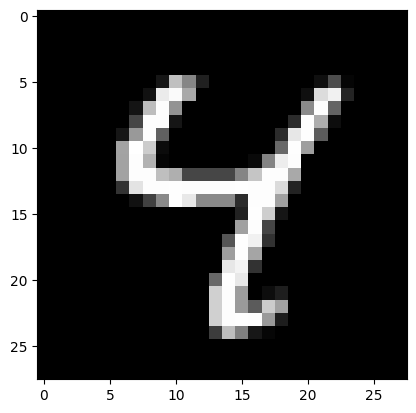

label=tensor(4)
pred=tensor([4], device='cuda:0')


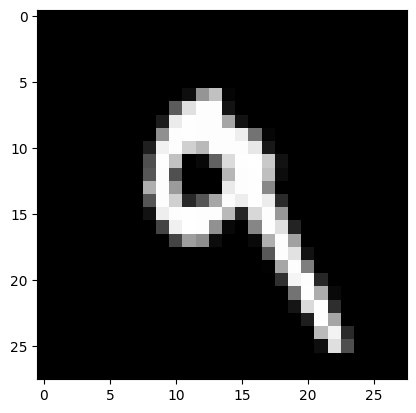

label=tensor(9)
pred=tensor([9], device='cuda:0')


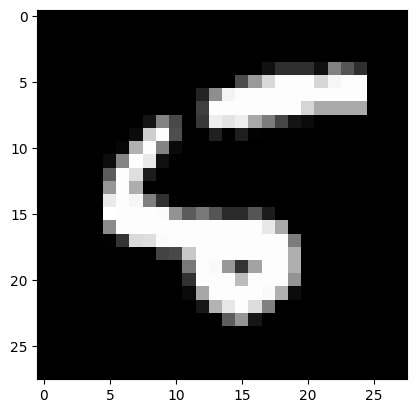

label=tensor(5)
pred=tensor([4], device='cuda:0')


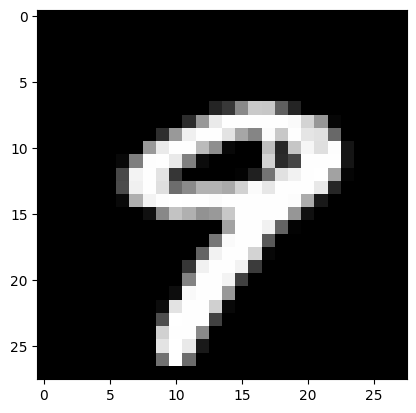

label=tensor(9)
pred=tensor([9], device='cuda:0')


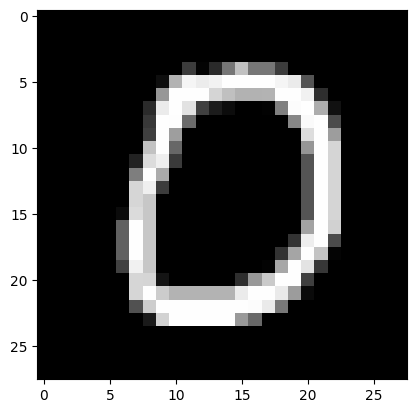

label=tensor(0)
pred=tensor([0], device='cuda:0')


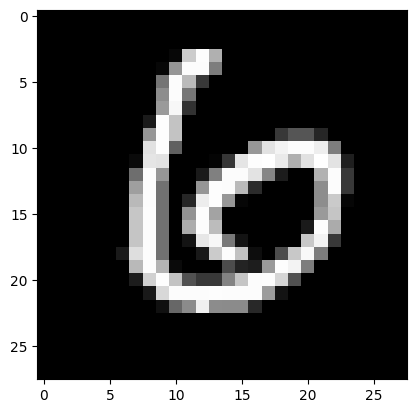

label=tensor(6)
pred=tensor([6], device='cuda:0')


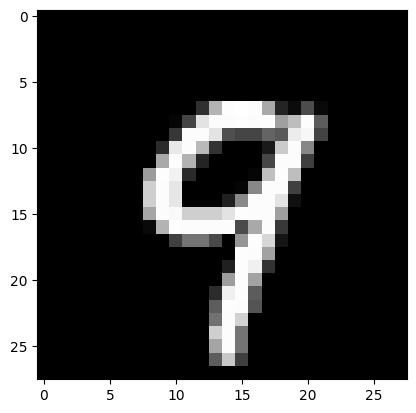

label=tensor(9)
pred=tensor([9], device='cuda:0')


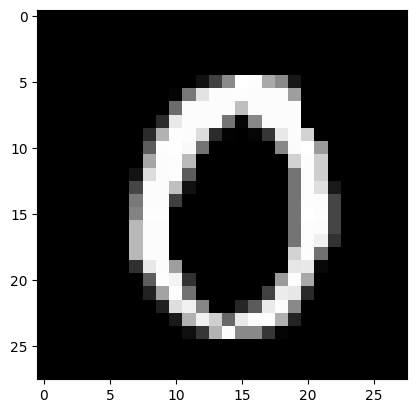

label=tensor(0)
pred=tensor([0], device='cuda:0')


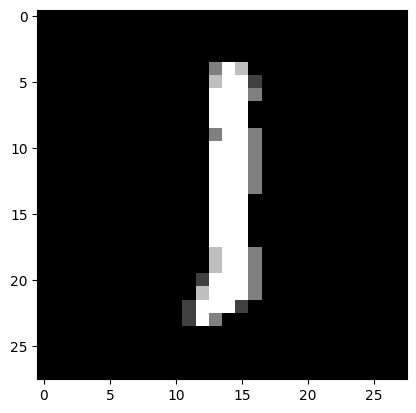

label=tensor(1)
pred=tensor([1], device='cuda:0')


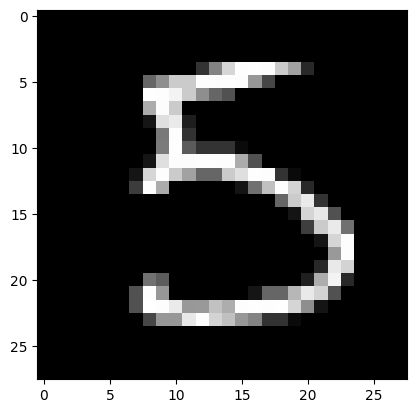

label=tensor(5)
pred=tensor([5], device='cuda:0')


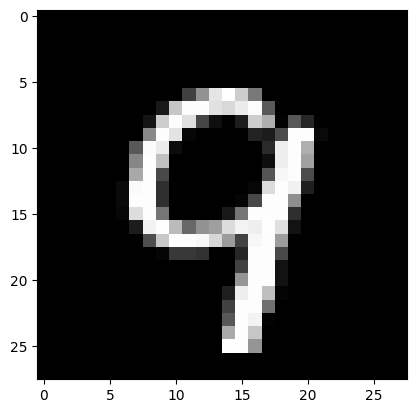

label=tensor(9)
pred=tensor([9], device='cuda:0')


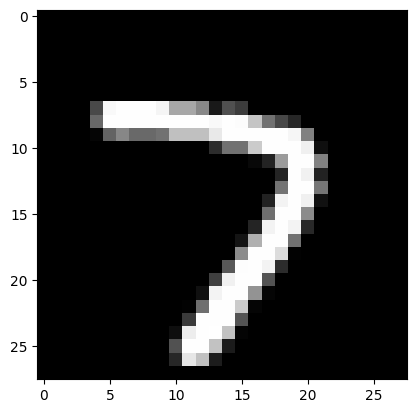

label=tensor(7)
pred=tensor([7], device='cuda:0')


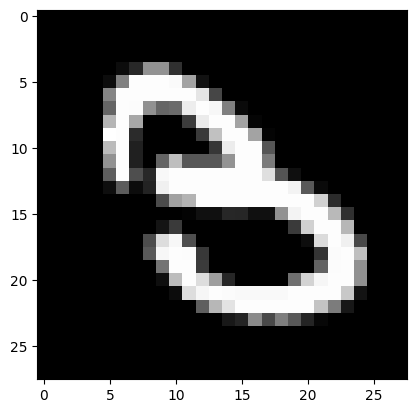

label=tensor(3)
pred=tensor([3], device='cuda:0')


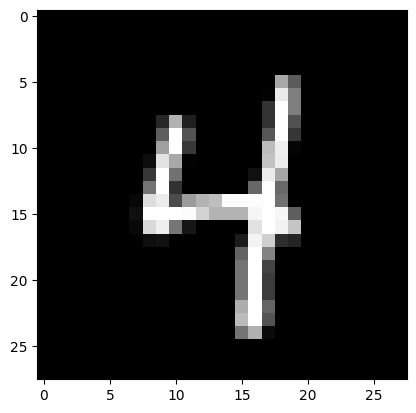

label=tensor(4)
pred=tensor([4], device='cuda:0')


In [ ]:
images, labels = next(iter(test_loader))
for image, label in islice(zip(images, labels), 20):
    _, pred = torch.max(net(Variable(image.view(-1, 28 * 28).cuda())), 1)
    plt.imshow(image.reshape(28, 28), cmap="gray")
    plt.show()

    print(f"{label=}")
    print(f"{pred=}")

<ipython-input-6-014133acf2f0>:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  weight_img = imageio.imread(weight_file)
<ipython-input-6-014133acf2f0>:19: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  bias_img = imageio.imread(bias_file)


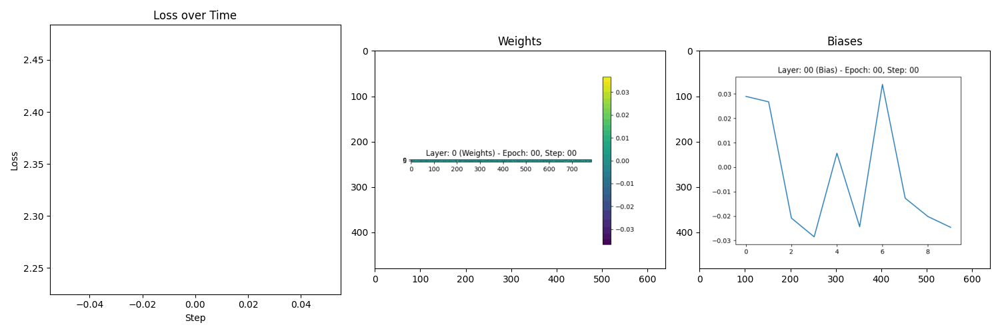

In [ ]:
create_combined_gif(loss_values, gif_frame_image_folder, "training_progress_combined.gif")
display(Image(filename="training_progress_combined.gif"))